<a href="https://colab.research.google.com/github/imatyushov/scratch-assay-segmentation/blob/main/scratch_assay.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!git clone https://github.com/Filip-GG/HuTu80

Cloning into 'HuTu80'...
remote: Enumerating objects: 385, done.
remote: Counting objects: 100% (18/18), done.
remote: Compressing objects: 100% (18/18), done.
remote: Total 385 (delta 2), reused 3 (delta 0), pack-reused 367 (from 1)
Receiving objects: 100% (385/385), 596.89 MiB | 26.42 MiB/s, done.
Resolving deltas: 100% (2/2), done.
Updating files: 100% (362/362), done.


In [3]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("user164919/hutu-80")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/hutu-80


In [4]:
import pandas as pd
import numpy as np
import torchvision
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from tqdm import tqdm
from PIL import Image

In [5]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [6]:
imgnet_data = torchvision.datasets.ImageFolder('/content/HuTu80/hutu-80/images')
mask_data = torchvision.datasets.ImageFolder('/content/HuTu80/hutu-80/masks')

imgnet_data, mask_data

(Dataset ImageFolder
     Number of datapoints: 180
     Root location: /content/HuTu80/hutu-80/images,
 Dataset ImageFolder
     Number of datapoints: 180
     Root location: /content/HuTu80/hutu-80/masks)

In [7]:
from sklearn.model_selection import train_test_split

img_train, img_test, mask_train, mask_test = train_test_split(
    imgnet_data,
    mask_data,
    test_size = 0.2,
    random_state = 42
    )

In [8]:
img_transforms = torchvision.transforms.Compose([
    torchvision.transforms.PILToTensor(),
    torchvision.transforms.Resize((520, 694)),
    torchvision.transforms.ConvertImageDtype(torch.float),
    torchvision.transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.2, 0.2, 0.2]),
])

mask_transforms = torchvision.transforms.Compose([
    torchvision.transforms.Grayscale(1),
    torchvision.transforms.PILToTensor(),
    torchvision.transforms.Resize((520, 694)),
    torchvision.transforms.ConvertImageDtype(torch.float),
    torchvision.transforms.Normalize(mean=1, std=-1),
])

In [9]:
class ImgDataset(torch.utils.data.Dataset):
    """Some Information about ImgDataset"""
    def __init__(self, imgnet, masks, img_transforms, mask_transforms):
        super(ImgDataset, self).__init__()
        self.imgnet = imgnet
        self.masks = masks
        self.img_transforms = img_transforms
        self.mask_transforms = mask_transforms

    def __getitem__(self, index):
        img = self.imgnet[index][0]
        lable = self.masks[index][0]

        img = self.img_transforms(img)
        lable = self.mask_transforms(lable)

        return (img, lable)

    def __len__(self):
        return len(self.imgnet)

In [10]:
data_train = ImgDataset(img_train, mask_train, img_transforms, mask_transforms)
data_test = ImgDataset(img_test, mask_test, img_transforms, mask_transforms)

In [11]:
batch_size = 1

dataloader_train = torch.utils.data.DataLoader(data_train, batch_size, shuffle=True)
dataloader_test = torch.utils.data.DataLoader(data_test, batch_size, shuffle=False)

In [12]:
model = torchvision.models.segmentation.fcn_resnet101(
    pretrained=True,
    progress=True,
    num_classes=21,
    weights_backbone=torchvision.models.ResNet101_Weights.IMAGENET1K_V2
)

model.to(device)


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FCN_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=FCN_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fcn_resnet101_coco-7ecb50ca.pth" to /root/.cache/torch/hub/checkpoints/fcn_resnet101_coco-7ecb50ca.pth
100%|██████████| 208M/208M [00:01<00:00, 169MB/s]


FCN(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequenti

In [13]:
def img_sampl(data):
  data = data > 0.5
  data = data * 1
  data = data.float()
  return data

In [14]:
def pixel_acc(predict_tensot, lable_rensot):

    predict_tensot = img_sampl(predict_tensot)
    lable_rensot = lable_rensot

    correct_pixels = (predict_tensot == lable_rensot).count_nonzero()
    uncorrect_pixels = (predict_tensot != lable_rensot).count_nonzero()
    result = (correct_pixels / (correct_pixels + uncorrect_pixels)).item()

    return result

In [15]:
def accuracy_model(model, test_loader):
    score = []
    for data in tqdm(test_loader):
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        out = model(inputs)

        score.append(pixel_acc(out['out'], labels))

    return score

In [19]:
def train(model, testloader, trainloader, optimizer, criterion, epoch, save = False):

    loss_stats = {
        'loss_func': [],
        'Pixel Acc': []
    }

    for ep in range(epoch):

        model.train()

        running_loss = 0.0
        for data in (bar := tqdm(trainloader)):
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()

            outputs = model(inputs)

            loss = criterion(outputs['out'], labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()

            bar.set_description(f'epoch: {ep}\tloss: {running_loss:.3F}')

        loss_stats['loss_func'].append(running_loss)

        model.eval()

        loss_stats['Pixel Acc'].append(accuracy_model(model, testloader))

    return loss_stats

In [20]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

In [21]:
stats = train(
    model,
    dataloader_test,
    dataloader_train,
    optimizer,
    criterion,
    81
)

100%|██████████| 36/36 [00:07<00:00,  4.68it/s]


Save model:

In [73]:
torch.save(model.state_dict(), 'fcn_resnet101_hutu80.pth')

Load model:

In [ ]:
model.load_state_dict(torch.load('cn_resnet101_hutu80.pth'))

In [22]:
median_acc = list(map(lambda x: sum(x)/len(x), stats['Pixel Acc']))

In [23]:
from matplotlib import pyplot as plt
import pylab

##Accuracy

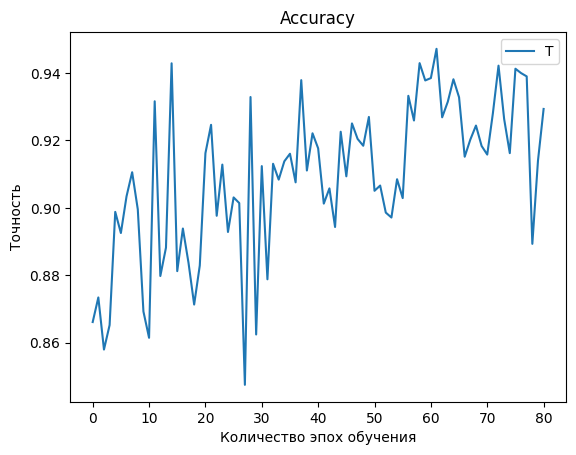

In [33]:
plt.plot(median_acc)
plt.title('Accuracy')
plt.legend('Точность')
plt.xlabel('Количество эпох обучения')
plt.ylabel('Точность')
plt.show()

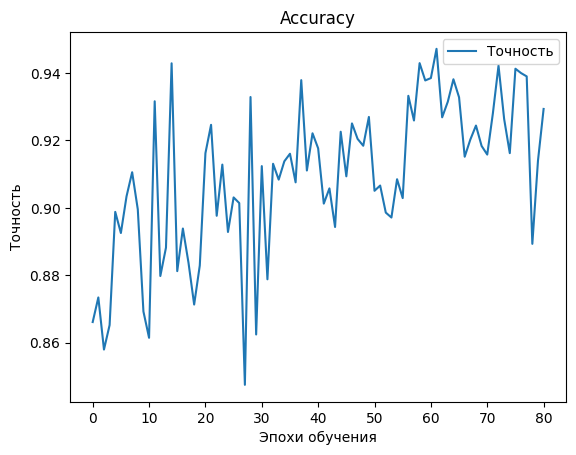

In [46]:
plt.plot(median_acc)
plt.title('Accuracy')
plt.legend(['Точность'])
plt.xlabel('Эпохи обучения')
plt.ylabel('Точность')
plt.show()

## Loss fn

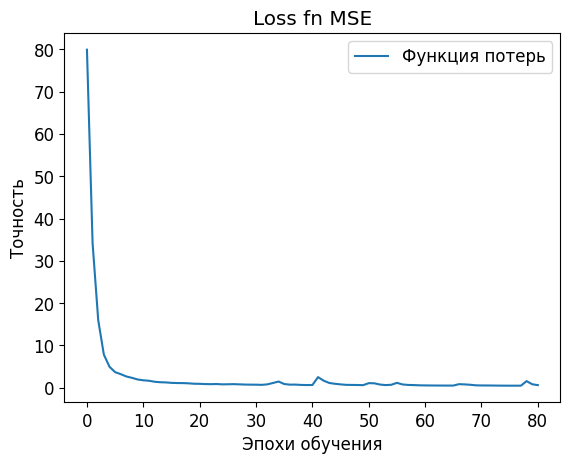

In [78]:
plt.plot(stats['loss_func'])
plt.title('Loss fn MSE')
plt.legend(['Функция потерь'])
plt.xlabel('Эпохи обучения')
plt.ylabel('Точность')
plt.show()

In [39]:
def test(model, test_loader):
    for data in tqdm(test_loader):
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        # Преобразования для визуализации
        trans_RGB = torchvision.transforms.ToPILImage('RGB')
        trans_L = torchvision.transforms.ToPILImage('L')

        # Предсказание модели
        out = model(inputs)

        # Визуализация результатов
        fig, ax = plt.subplots(ncols=3, figsize=(15, 5))
        ax[0].imshow(trans_RGB(inputs.to('cpu')[0]))
        ax[0].set_title("Original Image")

        ax[1].imshow(labels.to('cpu')[0, 0], cmap='viridis')  # Используем цветовую карту
        ax[1].set_title("Ground Truth Mask")

        ax[2].imshow(img_sampl(out['out']).to('cpu')[0, 0], cmap='plasma')  # Другая цветовая карта
        ax[2].set_title("Predicted Mask")

        for a in ax:
            a.axis("off")  # Убираем оси для чистоты изображения

        plt.tight_layout()
        plt.show()

  0%|          | 0/36 [00:00<?, ?it/s]

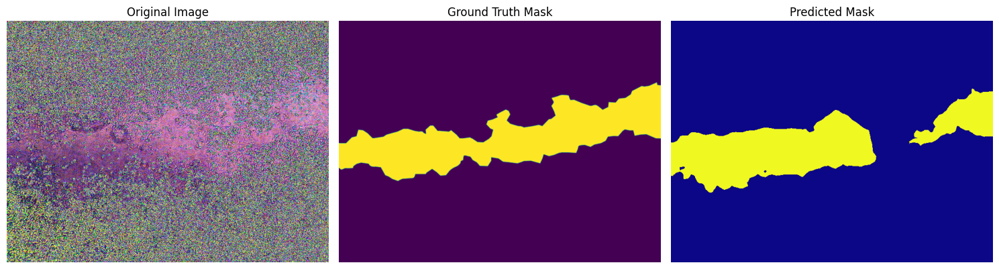

  3%|▎         | 1/36 [00:00<00:22,  1.59it/s]

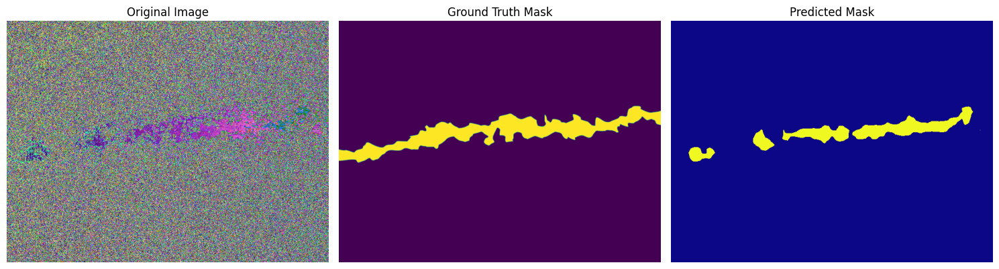

  6%|▌         | 2/36 [00:01<00:20,  1.69it/s]

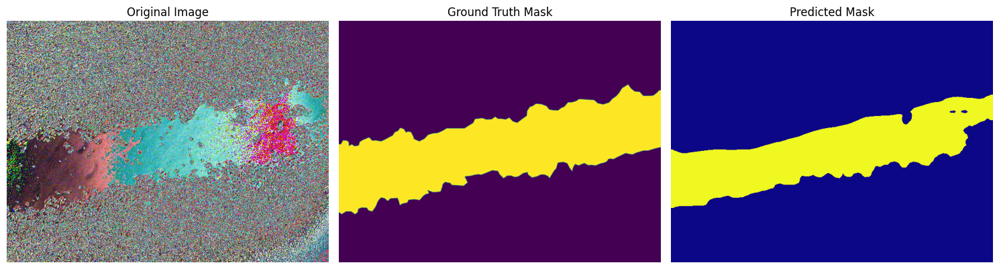

  8%|▊         | 3/36 [00:01<00:19,  1.73it/s]

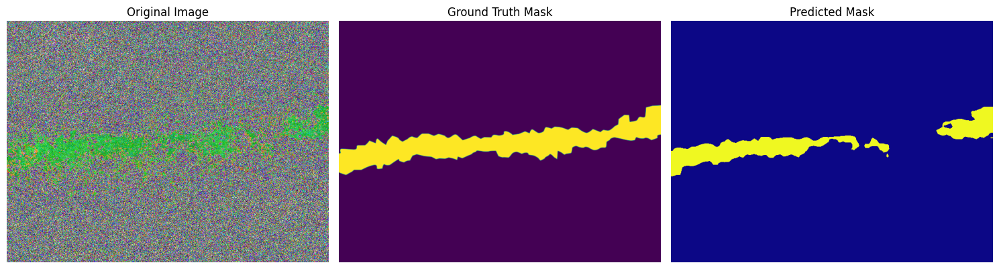

 11%|█         | 4/36 [00:02<00:18,  1.75it/s]

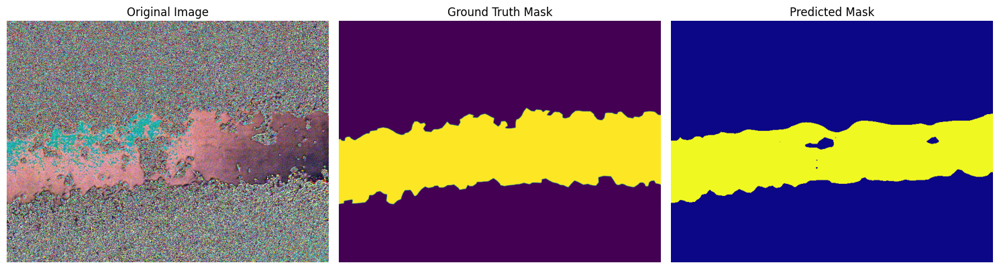

 14%|█▍        | 5/36 [00:02<00:17,  1.76it/s]

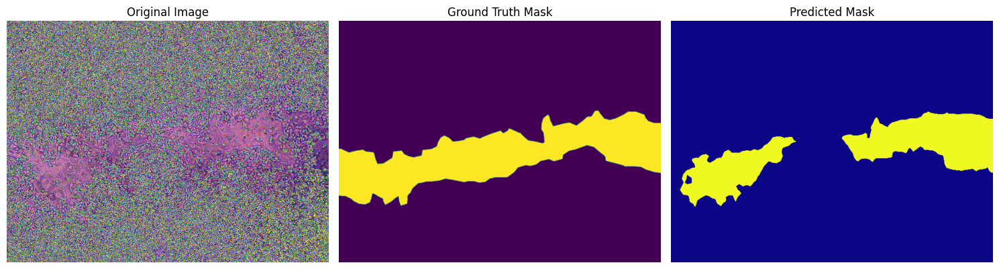

 17%|█▋        | 6/36 [00:03<00:18,  1.63it/s]

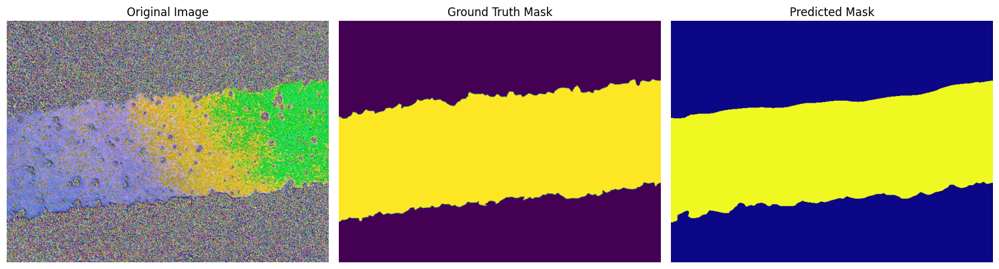

 19%|█▉        | 7/36 [00:04<00:17,  1.67it/s]

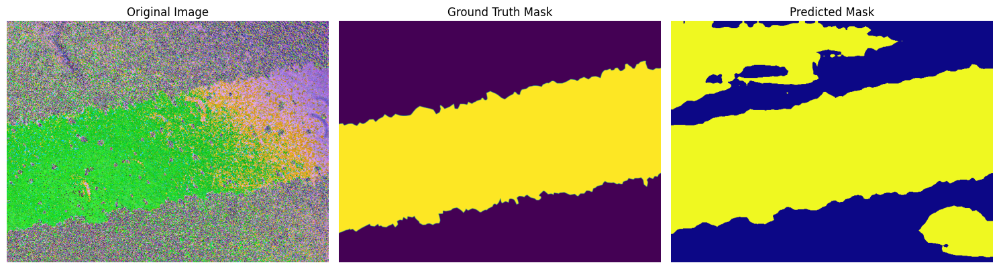

 22%|██▏       | 8/36 [00:04<00:16,  1.69it/s]

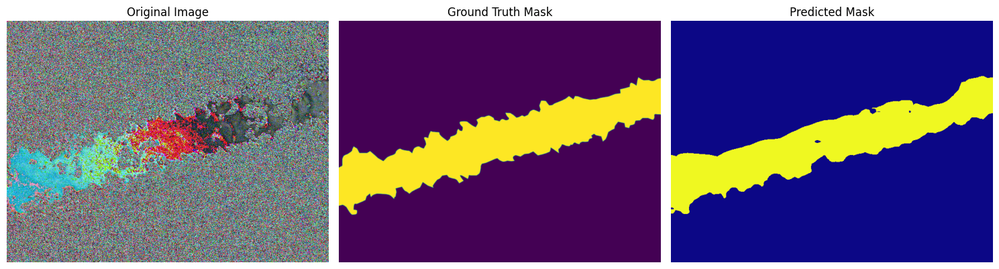

 25%|██▌       | 9/36 [00:05<00:15,  1.71it/s]

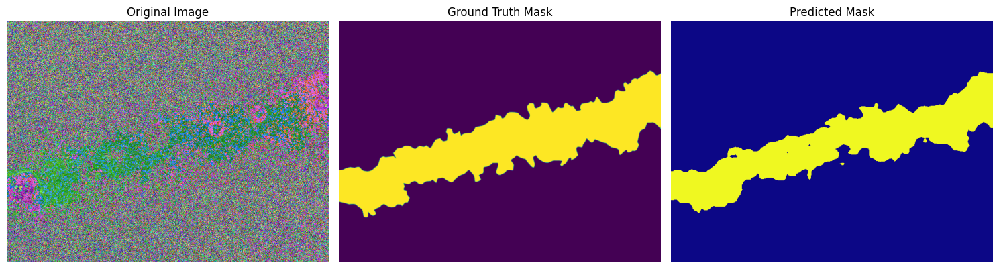

 28%|██▊       | 10/36 [00:05<00:15,  1.71it/s]

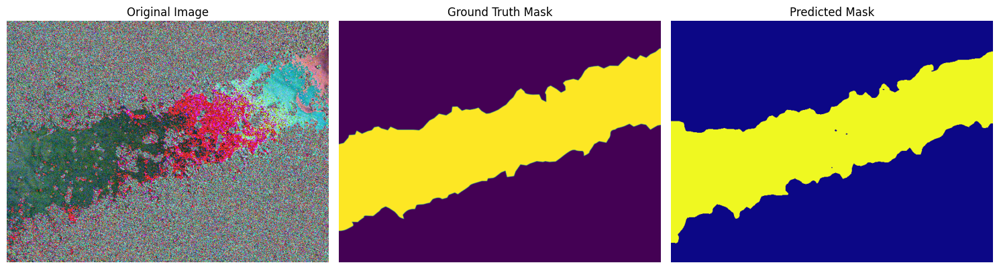

 31%|███       | 11/36 [00:06<00:14,  1.70it/s]

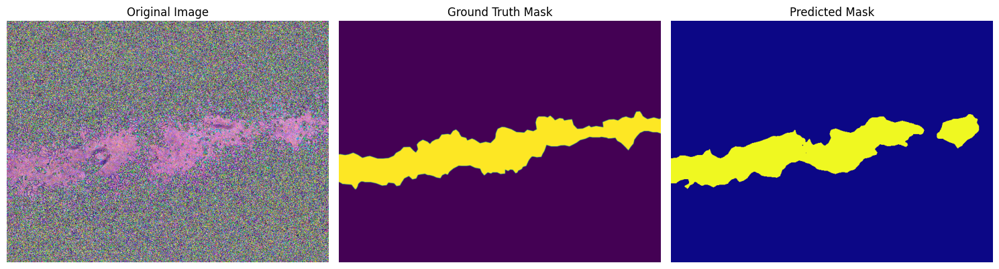

 33%|███▎      | 12/36 [00:07<00:14,  1.69it/s]

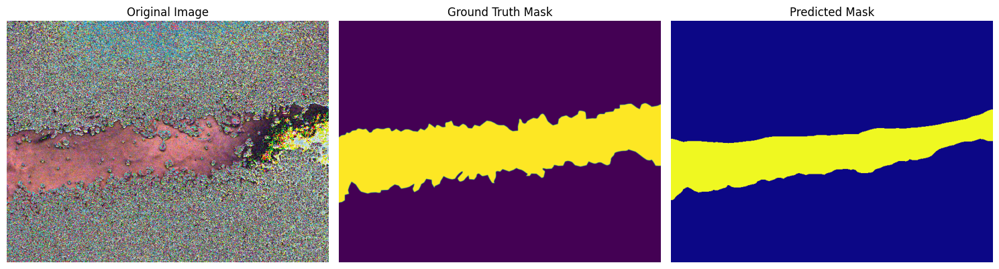

 36%|███▌      | 13/36 [00:07<00:13,  1.68it/s]

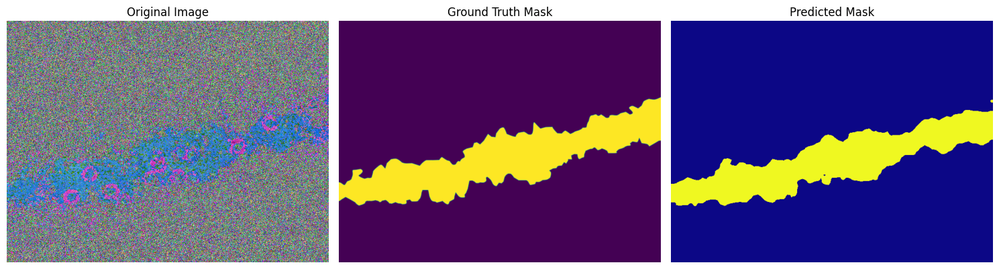

 39%|███▉      | 14/36 [00:08<00:14,  1.52it/s]

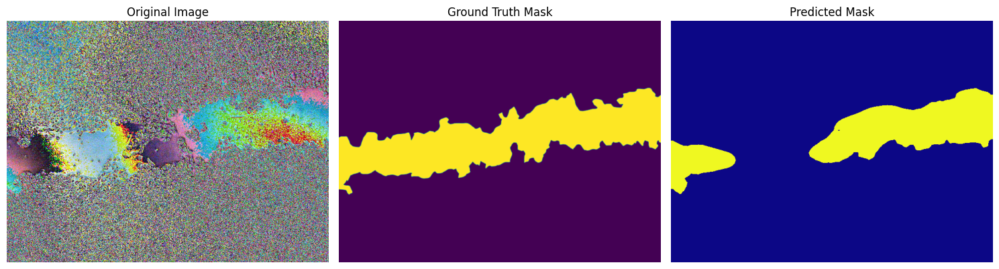

 42%|████▏     | 15/36 [00:09<00:14,  1.45it/s]

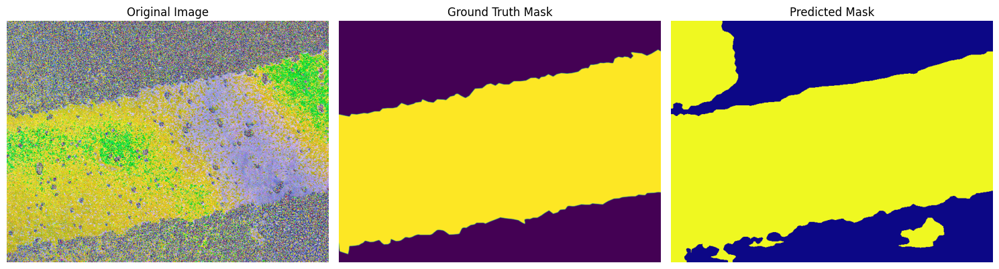

 44%|████▍     | 16/36 [00:10<00:14,  1.40it/s]

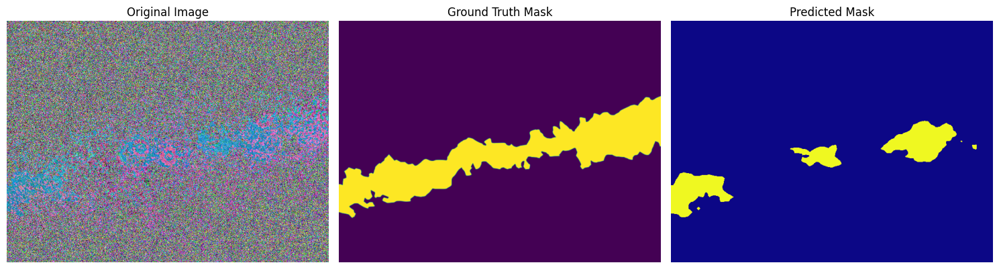

 47%|████▋     | 17/36 [00:10<00:14,  1.35it/s]

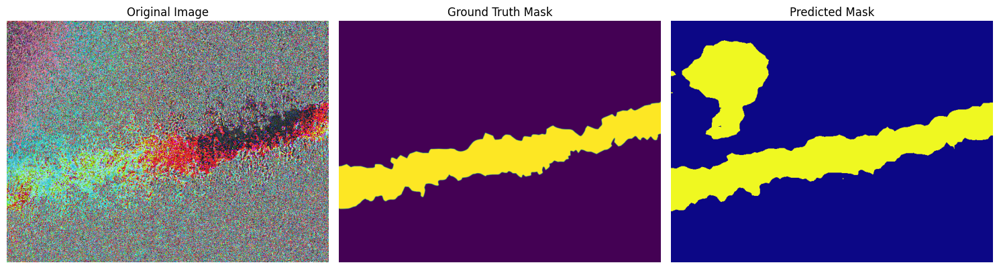

 50%|█████     | 18/36 [00:11<00:13,  1.30it/s]

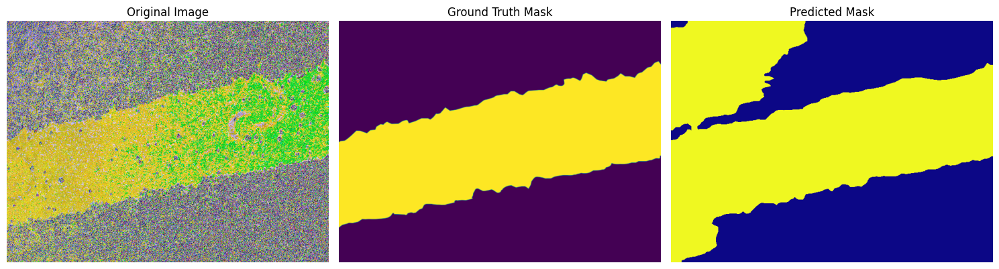

 53%|█████▎    | 19/36 [00:12<00:12,  1.36it/s]

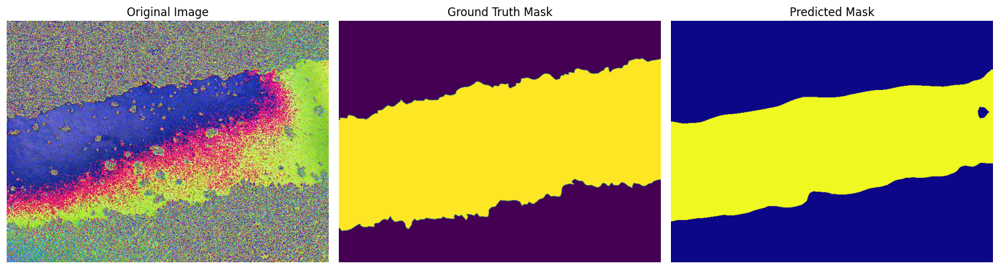

 56%|█████▌    | 20/36 [00:12<00:11,  1.40it/s]

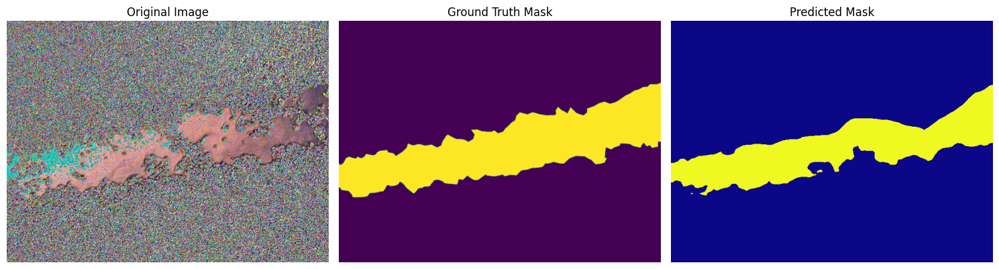

 58%|█████▊    | 21/36 [00:13<00:10,  1.44it/s]

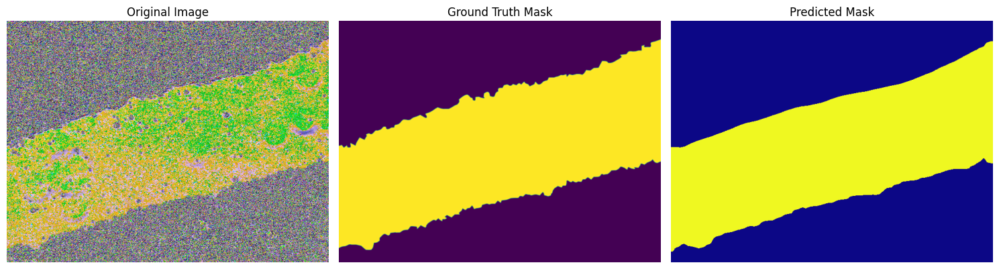

 61%|██████    | 22/36 [00:14<00:09,  1.46it/s]

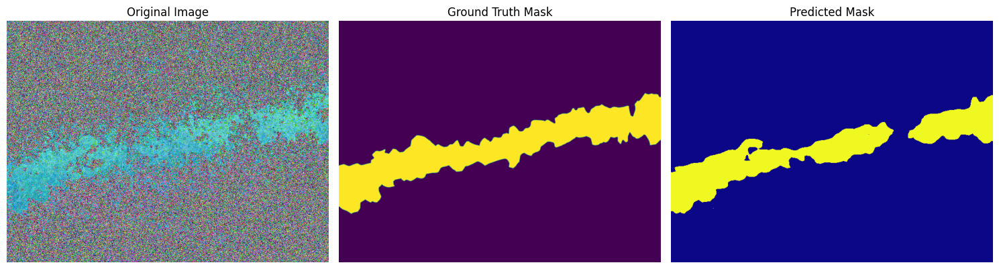

 64%|██████▍   | 23/36 [00:15<00:09,  1.39it/s]

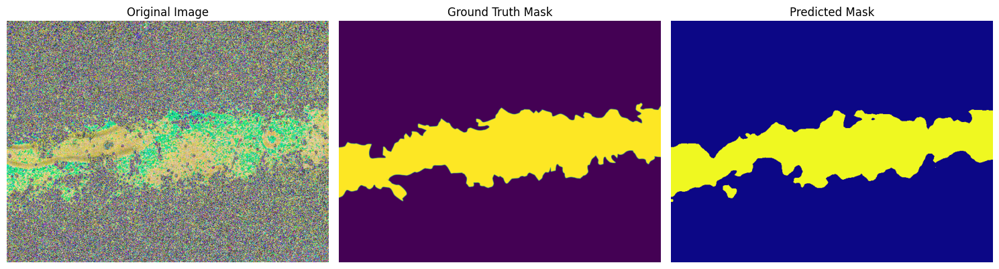

 67%|██████▋   | 24/36 [00:15<00:08,  1.43it/s]

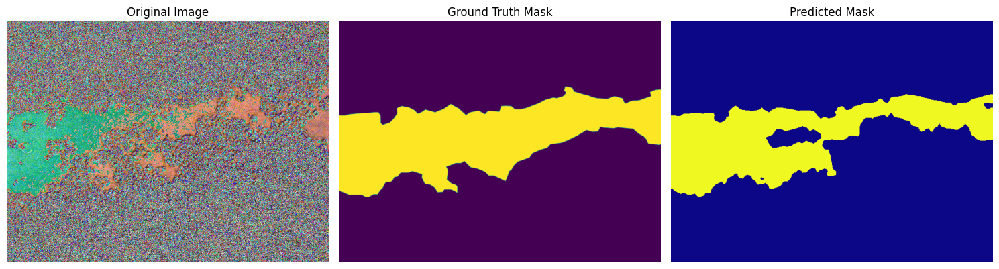

 69%|██████▉   | 25/36 [00:16<00:07,  1.46it/s]

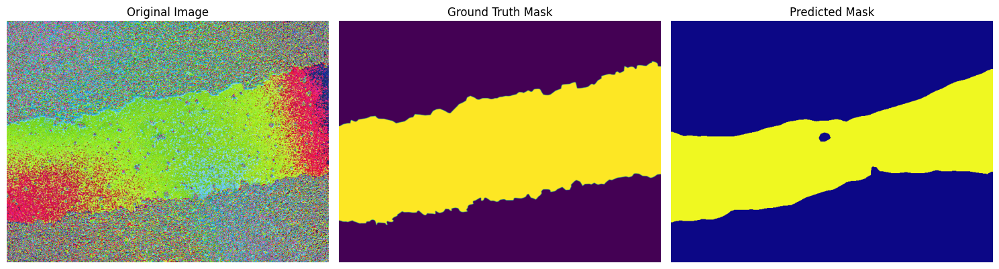

 72%|███████▏  | 26/36 [00:17<00:06,  1.45it/s]

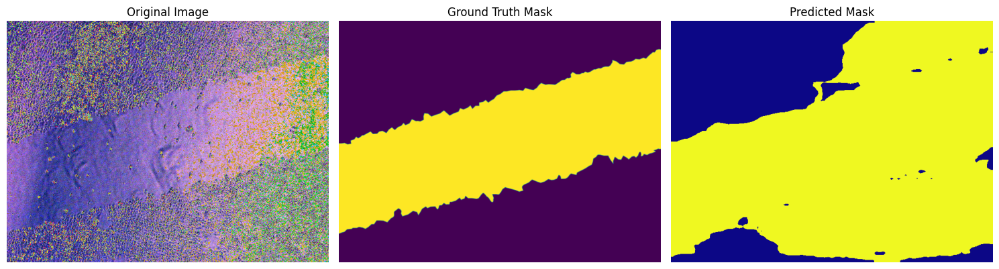

 75%|███████▌  | 27/36 [00:17<00:06,  1.47it/s]

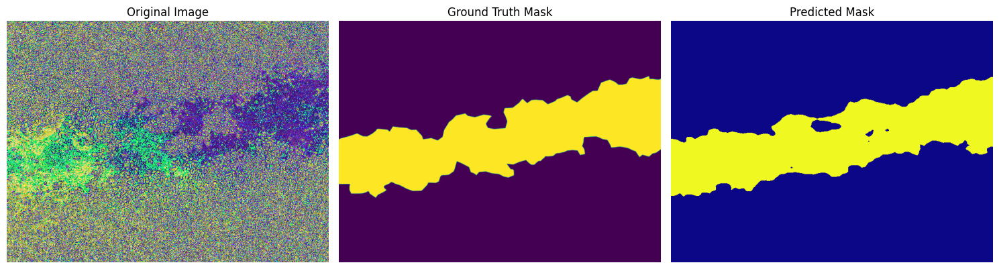

 78%|███████▊  | 28/36 [00:18<00:05,  1.47it/s]

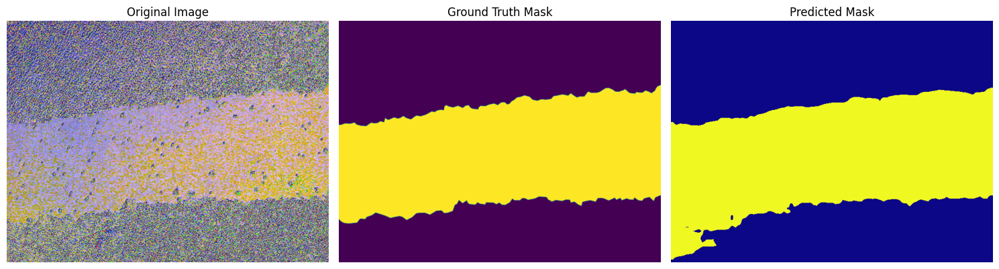

 81%|████████  | 29/36 [00:19<00:04,  1.46it/s]

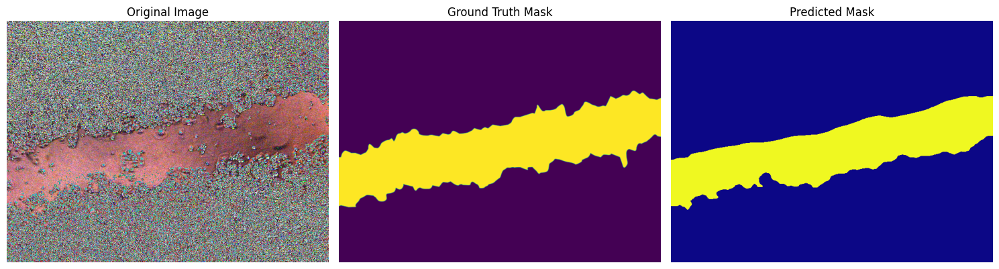

 83%|████████▎ | 30/36 [00:19<00:04,  1.46it/s]

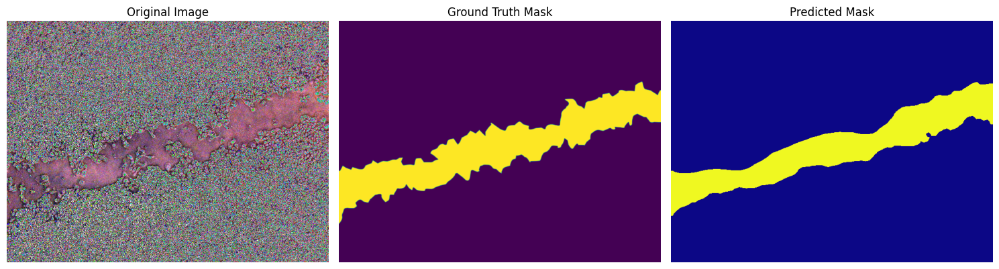

 86%|████████▌ | 31/36 [00:20<00:03,  1.45it/s]

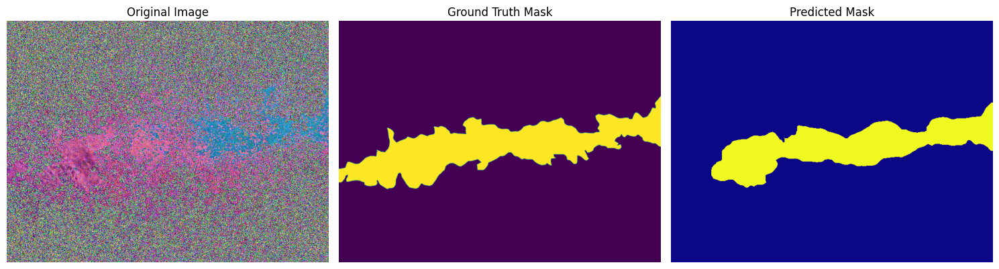

 89%|████████▉ | 32/36 [00:21<00:02,  1.43it/s]

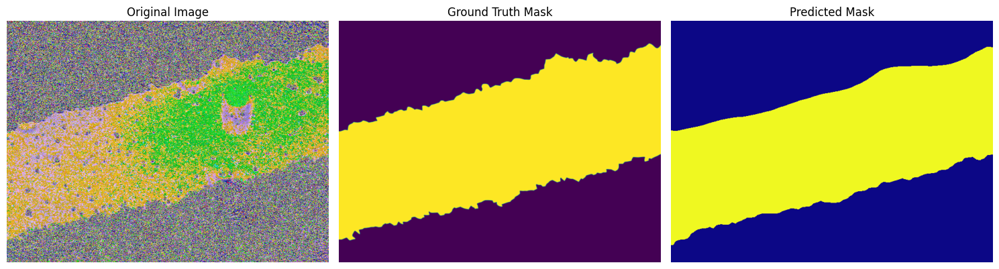

 92%|█████████▏| 33/36 [00:21<00:02,  1.40it/s]

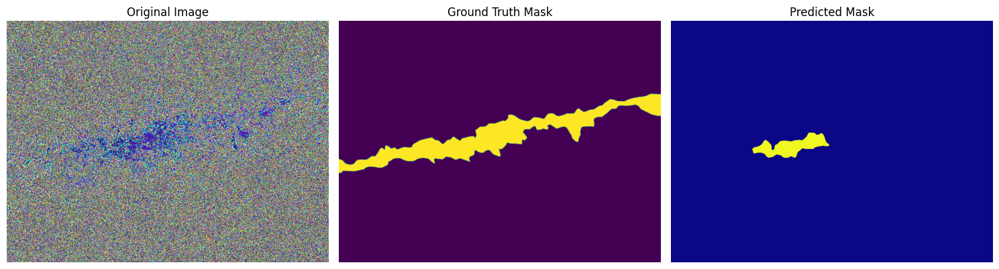

 94%|█████████▍| 34/36 [00:22<00:01,  1.34it/s]

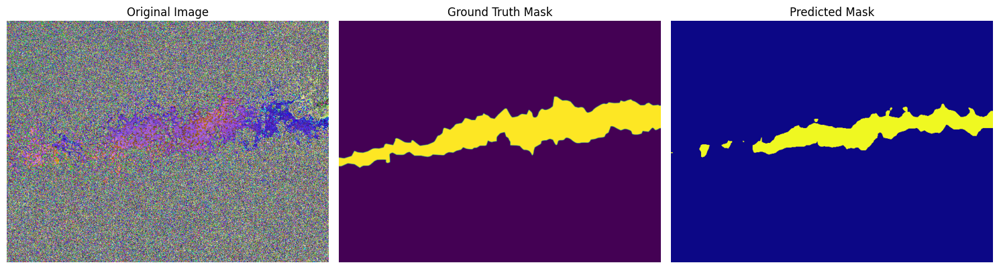

 97%|█████████▋| 35/36 [00:23<00:00,  1.34it/s]

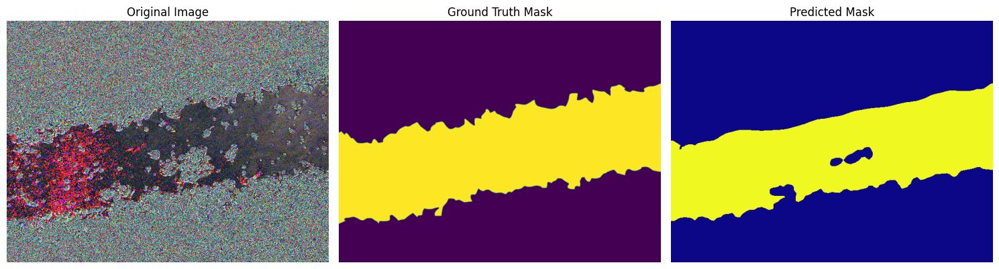

100%|██████████| 36/36 [00:24<00:00,  1.48it/s]


In [40]:
test(model, dataloader_test)

In [92]:
import torch
import numpy as np
from scipy.spatial.distance import directed_hausdorff
import torch.nn.functional as F

def img_sampl(data):
    data = data > 0.5
    data = data * 1
    data = data.float()
    return data

def calculate_metrics(pred, target, epsilon=1e-7):
    """
    Calculates Dice, Hausdorff distance, IoU, Precision, and Recall for binary segmentation.

    Args:
        pred (torch.Tensor): Predicted segmentation mask (binary).
        target (torch.Tensor): Ground truth segmentation mask (binary).
        epsilon (float): Small value to avoid division by zero.

    Returns:
        dict: Dictionary containing calculated metrics.
    """
    pred = img_sampl(pred)  # пороговая обработка предсказания

    # Изменение размера предсказания до размера цели
    pred = F.interpolate(pred.unsqueeze(0).float(), size=target.shape[1:], mode='bilinear', align_corners=False).squeeze(0)

    # Переводим в numpy для удобства расчетов
    pred_np = pred.cpu().detach().numpy().flatten()
    target_np = target.cpu().detach().numpy().flatten()

    # Intersection and union
    intersection = np.sum(pred_np * target_np)
    union = np.sum(pred_np) + np.sum(target_np)

    # Dice coefficient
    dice = (2. * intersection + epsilon) / (union + epsilon)

    # IoU (Intersection over Union)
    iou = (intersection + epsilon) / (np.sum(pred_np != target_np) + epsilon)

    # Precision and recall
    precision = (intersection + epsilon) / (np.sum(pred_np) + epsilon)
    recall = (intersection + epsilon) / (np.sum(target_np) + epsilon)

    # Hausdorff distance (95th percentile)
    hausdorff_distance = directed_hausdorff(pred_np, target_np)[0]

    return {
        'Dice': dice,
        'Hausdorff': hausdorff_distance,
        'IoU': iou,
        'Precision': precision,
        'Recall': recall
    }

In [93]:
def test(model, test_loader, device):
    model.eval()  # переводим модель в режим оценки
    metrics = []  # список для хранения метрик по всем батчам

    with torch.no_grad():  # отключаем расчет градиентов
        for data in tqdm(test_loader):
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)

            # Предсказание модели
            out = model(inputs)
            pred_mask = out['out']  # получаем предсказанную маску

            # Рассчитываем метрики
            batch_metrics = calculate_metrics(pred_mask.squeeze(), labels.squeeze())
            metrics.append(batch_metrics)

    return metrics


In [95]:
# После обучения
metrics = test(model, dataloader_test, device)

# Вывод средних значений метрик
avg_metrics = {k: np.mean([m[k] for m in metrics]) for k in metrics[0]}
print(f"Average Metrics: {avg_metrics}")